# Gridding and Non-uniform fast Fourier transform (NUFFT)

This is based on the nufft guided example in the GitHub 'Guide' - in that hands-on guide there is more information abut the gridder itself

However here we will do forwards and backwards gridding of a 
- 2D object, 1 coil
- 2D object, multicoil
- 2D+time object, 1 coil
- 2D+time object, 1 multicoil

We will demomstrate radial and spiral trajectories

## Guided example
As an example, let's take an image of the Shepp-Logan phantom (2D) and evaluate its
Fourier transform on a set of sampling points defining a radial *k*-space
trajectory, using a forward, type-2 NUFFT. Then we will see how to recover
the image from the radial *k*-space data, using a backward, type-1 NUFFT.

In [16]:
%pip install -q tensorflow tensorflow-mri

You should consider upgrading via the '/usr/local/bin/python -m pip install --upgrade pip' command.
Note: you may need to restart the kernel to use updated packages.


Now import both packages and other we might need

In [17]:
import tensorflow as tf
import tensorflow_mri as tfmri

import matplotlib.pyplot as plt
import matplotlib.animation
import numpy as np

Now we will create a 2D example image using
[`tfmri.image.phantom`](https://mrphys.github.io/tensorflow-mri/api_docs/tfmri/image/phantom/):

In [18]:
# Create phantom
base_resolution = 256
image_shape = [base_resolution, base_resolution]

# Create
image = tfmri.image.phantom(shape=image_shape, dtype=tf.complex64)

print("image: \n - shape: {}\n - dtype: {}".format(image.shape, image.dtype))
#(256, 256)

fig1 = plt.figure(1, figsize=(8, 8)); fig1.suptitle("2D Phantom", fontsize=14)
tmp = plt.imshow(np.abs(image), aspect= 'auto')
plt.xlabel('x');plt.ylabel('y'); tmp.set_clim(0.0,0.8*np.max(np.abs(image))) # y by x

image: 
 - shape: (256, 256)
 - dtype: <dtype: 'complex64'>


Let us also create a *k*-space trajectory. In this example we will create the
radial trajectory, similarly to what is used in the UNet dealiasng example in the tutorials.

The trajectory should have shape `[..., M, N]`, where `M` is the number of
points and `N` is the number of dimensions. Any additional dimensions `...` will
be treated as batch dimensions.

Spatial frequencies should be provided in radians/voxel, ie, in the range
`[-pi, pi]`.

Finally, we'll also need density compensation weights for our set of nonuniform
points. These are necessary in the adjoint transform, to compensate for the fact
that the sampling density in a radial trajectory is not uniform.

In [19]:
radial_spokes = 30

trajectory = tfmri.sampling.radial_trajectory(
    base_resolution=256, views=radial_spokes, flatten_encoding_dims=True)

print('trajectory.shape: ', trajectory.shape)
#trajectory.shape:  (15360, 2)

# Compute density.
density = tfmri.sampling.radial_density(base_resolution=256, views=radial_spokes)
density = tf.reshape(density, [-1])

print('density.shape: ', density.shape)
#density.shape:  (15360,)

trajectory.shape:  (15360, 2)
density.shape:  (15360,)


### Forward transform (image to *k*-space)

Next, let's calculate the k-space coefficients for the given image and trajectory points (image to k-space transform).

In [20]:
kspace = tfmri.signal.nufft(image, trajectory,
                            transform_type='type_2',
                            fft_direction='forward')

print(kspace.shape)
# (15360,)

(15360,)


We are using a type-2 transform (uniform to nonuniform) and a forward FFT
(image domain to frequency domain). These are the default values for
`transform_type` and `fft_direction`, so providing them was not necessary in
this case.

### Adjoint transform (*k*-space to image)

We will now perform the adjoint transform to recover the image given the
*k*-space data. In this case, we will use a type-1 transform (nonuniform to
uniform) and a backward FFT (frequency domain to image domain). Also note that,
prior to evaluating the NUFFT, we will compensate for the nonuniform sampling
density by simply dividing the *k*-space samples by the density weights.
Finally, for type-1 transforms we need to specify an additional `grid_shape`
argument, which should be the size of the image. If there are any batch
dimensions, `grid_shape` should **not** include them.

In [31]:
print('kspace.shape: ', kspace.shape, ' , density.shape: ', density.shape)
# Apply density compensation.
kspace /= tf.cast(density, tf.complex64)

#Now do NUFFT 
recon = tfmri.signal.nufft(kspace, trajectory,
                           grid_shape=image_shape,
                           transform_type='type_1',
                           fft_direction='backward')

print('recon.shape: ', recon.shape)

kspace.shape:  (15360,)  , density.shape:  (15360,)
recon.shape:  (256, 256)


Finally, let's visualize the images.

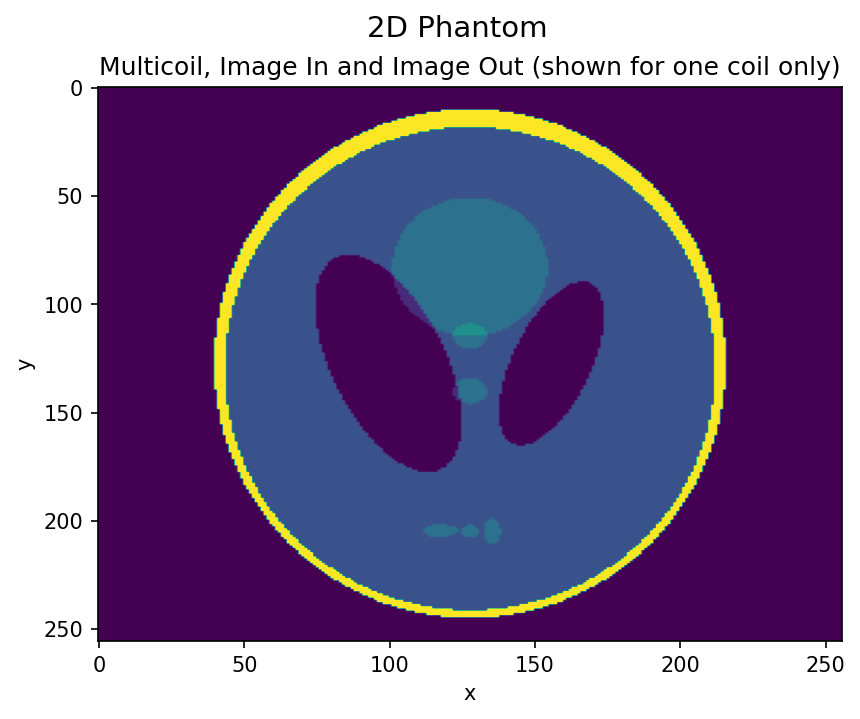

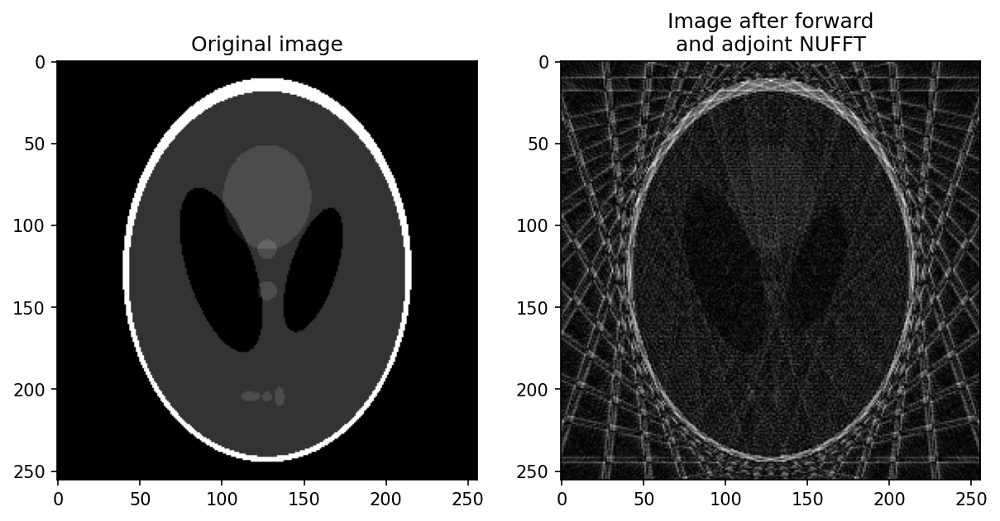

In [22]:
def plot_images(image, recon):
  _, ax = plt.subplots(1, 2, figsize=(9.6, 5.4))
  ax[0].imshow(tf.abs(image), cmap='gray')
  ax[0].set_title("Original image")
  ax[1].imshow(tf.abs(recon), cmap='gray')
  ax[1].set_title("Image after forward\nand adjoint NUFFT")
  plt.show()
  
plot_images(image, recon)

### Use the linear operator
You can also use
[`tfmri.linalg.LinearOperatorNUFFT`](https://mrphys.github.io/tensorflow-mri/api_docs/tfmri/linalg/LinearOperatorNUFFT/)
to perform forward and adjoint NUFFT. This might be particularly useful when
building MRI reconstruction methods, as you can take advantage of the features
of the [linear algebra framework](https://mrphys.github.io/tensorflow-mri/guide/linalg/).

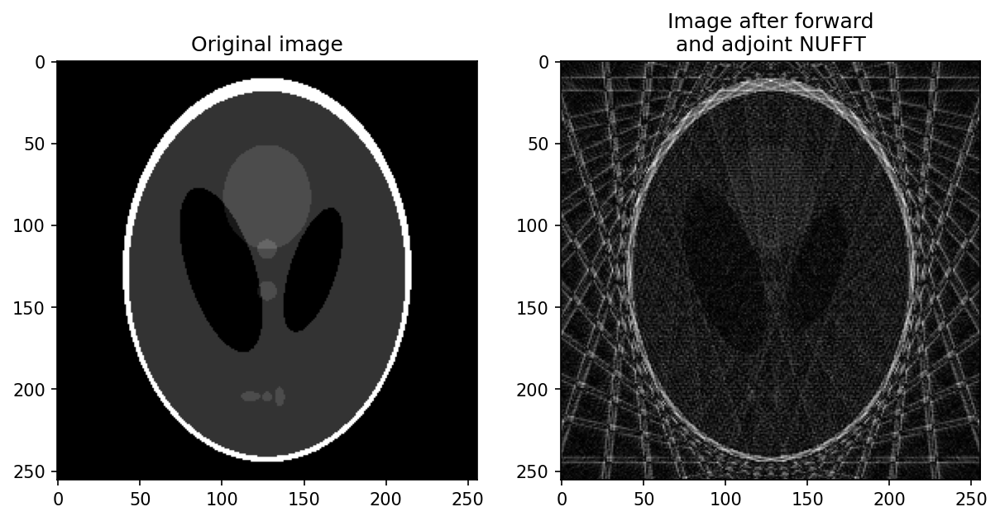

In [23]:
# Create the linear operator for the specified image shape, trajectory and
# density.
linop_nufft = tfmri.linalg.LinearOperatorNUFFT(
    image_shape, trajectory=trajectory, density=density)

# Apply forward transform to obtain the *k*-space signal given an image.
kspace = linop_nufft.transform(image)

# Apply adjoint transform to obtain an image given a *k*-space signal.
recon = linop_nufft.transform(kspace, adjoint=True)

plot_images(image, recon)

# 2D multicoil gridding

The above example was a single coil 2D image.
Lets try doing NUFFT for a multicoil image....

Remember, that the trajectory and the density have not changed so we do not need to re-calculate these.

image_multiCoil.shape:  (12, 256, 256)
kspace_multiCoil.shape:  (12, 15360)
recon_multiCoil.shape:  (12, 256, 256)


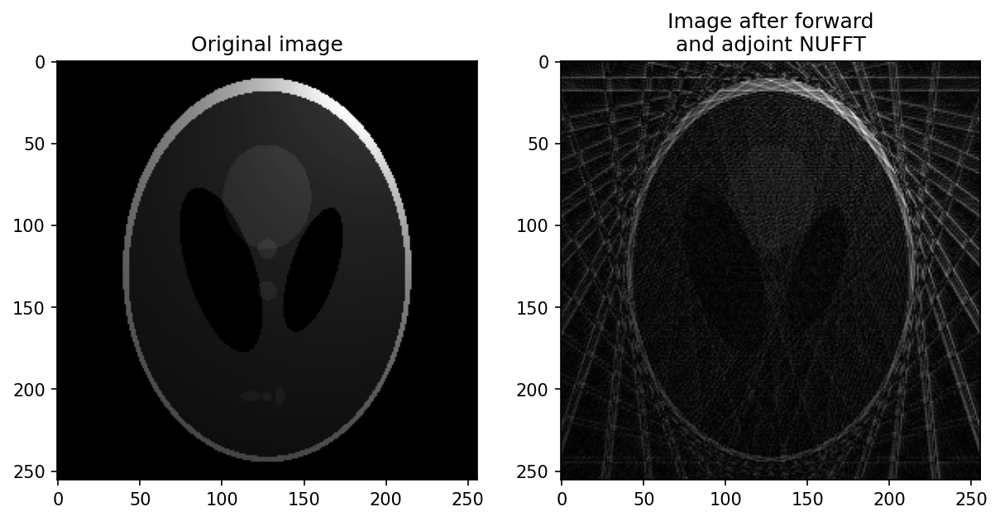

In [24]:
# Create the shepp-logan phantom with 12 coil elements
nCoils = 12
image_multiCoil = tfmri.image.phantom(shape=image_shape, dtype=tf.complex64, num_coils=nCoils)
print('image_multiCoil.shape: ', image_multiCoil.shape)
# (12,256, 256)

#Now do NUFFT to create non-Cartesian k-space as sampled on this radial trajectory
kspace_multiCoil = tfmri.signal.nufft(image_multiCoil, trajectory,
                            transform_type='type_2',
                            fft_direction='forward')
print('kspace_multiCoil.shape: ', kspace_multiCoil.shape)
#(12, 15360)

# Apply density compensation.
kspace_multiCoil /= tf.cast(density, tf.complex64)

# Now to NUFFT to get image from this radial kspace
recon_multiCoil = tfmri.signal.nufft(kspace_multiCoil, trajectory,
                           grid_shape=image_shape,
                           transform_type='type_1',
                           fft_direction='backward')
print('recon_multiCoil.shape: ', recon_multiCoil.shape)
# (12,256, 256)

coil = 10
plot_images(np.squeeze(image_multiCoil[coil,:,:]), np.squeeze(recon_multiCoil[coil,:,:]))

The above example was 2D multi-coil image
Now lets make it a 2D+time image (single coil only)

In [25]:
#Now add time
# Create a 3D phantom and we will assume it is 2D plus time for this tutorial
original_time_image_shape = [100, 256, 256]
time_image = tfmri.image.phantom(phantom_type = 'modified_kak_roberts', shape=original_time_image_shape, dtype=tf.complex64) #, This is a 3D phantom
# The above phantom has 100 slices, aka 'time points' so we are just going to extract 20 from the centre
time_image = time_image[28:48,:,:]
time_image_shape = time_image.shape
print(time_image.shape)
#(20, 256, 256)

nFrames = time_image.shape[0]

# And lets visualise

plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['figure.dpi'] = 150  
plt.ioff()
fig, ax = plt.subplots()

t= np.linspace(0,nFrames)
def animate(t):
    plt.imshow(np.squeeze(tf.math.abs(time_image[t,:,:])), cmap = 'gray')
    plt.title('Image')

matplotlib.animation.FuncAnimation(fig, animate, frames=nFrames)


(20, 256, 256)


In [26]:
# Now we need to calculate the 2D+time radial trajectory

time_trajectory = tfmri.sampling.radial_trajectory(
    base_resolution=base_resolution, views=radial_spokes, phases = nFrames, flatten_encoding_dims=True, ordering= 'tiny')
print('time_trajectory.shape: ', time_trajectory.shape)
# (20, 15360, 2)

# And caalculate the density compensation for this trajectory
time_density = tfmri.sampling.radial_density(base_resolution=base_resolution, views=radial_spokes, phases=nFrames, flatten_encoding_dims=True, ordering= 'tiny')
print('time_density.shape: ', time_density.shape)
# (20, 15360)

# and do 2D+t NUFFT to create the undersampled, radial k-space from a Cartesian image
time_kspace = tfmri.signal.nufft(time_image, time_trajectory,
                            transform_type='type_2',
                            fft_direction='forward')
print('time_kspace.shape: ', time_kspace.shape)
# (20, 15360)

# Now lets go back into image space
# Apply density compensation.
time_kspace /= tf.cast(time_density, tf.complex64)

# and do 2D+t NUFFT to create the image from the undersampled radial kspace 
time_recon = tfmri.signal.nufft(time_kspace, time_trajectory,
                           grid_shape=image_shape, # Note that this is still [256, 256]
                           transform_type='type_1',
                           fft_direction='backward')
print('time_recon.shape: ', time_recon.shape)
# (20, 256, 256)

# And lets visualise
plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['figure.dpi'] = 150  
plt.ioff()
fig, ax = plt.subplots()

t= np.linspace(0,nFrames)
def animate(t):
    plt.imshow(np.concatenate(((np.squeeze(tf.math.abs(time_image[t,:,:]))*100000, np.squeeze(tf.math.abs(time_recon[t,:,:])))), axis=1), cmap = 'gray')
    plt.title('Image In and Image Out')

matplotlib.animation.FuncAnimation(fig, animate, frames=nFrames)

/usr/local/lib/python3.8/dist-packages/tensorflow_mri/python/ops/traj_ops.py:404: UserWarning: When using tiny golden angle ordering, optimal k-space filling is achieved when the number of views is a member of the generalized Fibonacci sequence: 1, 7, 8, 15, 23, 38, 61, 99, 160, 259..., but the specified number (30) is not a member of this sequence.
  warnings.warn(


time_trajectory.shape:  (20, 15360, 2)
time_density.shape:  (20, 15360)
time_kspace.shape:  (20, 15360)
time_recon.shape:  (20, 256, 256)


The above example was 2D multi-coil image with a single coil only
Now lets make it a 2D+time image with multiple coil elements

In [27]:
#Now add time and coils
# Create a 3D phantom and we will assume it is 2D plus time for this tutorial
multicoil_time_image = tfmri.image.phantom(phantom_type = 'modified_kak_roberts', shape=original_time_image_shape, dtype=tf.complex64, num_coils=nCoils) #, This is a 3D phantom
print('original phantom shape: ', multicoil_time_image.shape)
# (12, 100, 256, 256)

# The above phantom has 100 slices, aka 'time points' so we are just going to extract 20 from the centre
multicoil_time_image = multicoil_time_image[:,28:48,:,:]

multicoil_time_image_shape = multicoil_time_image.shape
print(multicoil_time_image_shape)
#(12, 20, 256, 256)
# coils time x y

nFrames = multicoil_time_image_shape[1]

# And lets visualise
plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['figure.dpi'] = 150  
plt.ioff()
fig, ax = plt.subplots()

t= np.linspace(0,nFrames)
def animate(t):
    plt.imshow(np.squeeze(tf.math.abs(multicoil_time_image[3,t,:,:])), cmap = 'gray')
    plt.title('Image for one coil')

matplotlib.animation.FuncAnimation(fig, animate, frames=nFrames)

original phantom shape:  (12, 100, 256, 256)
(12, 20, 256, 256)


In [28]:
# Remember that the trajectory or density dont change from above...
# so do 2D+t NUFFT to create the  undersampled radial kspace from the Cartesian image
multicoil_time_kspace = tfmri.signal.nufft(multicoil_time_image, time_trajectory,
                            transform_type='type_2',
                            fft_direction='forward')
print('multicoil_time_kspace.shape: ', multicoil_time_kspace.shape)
# (12, 20, 15360)

# Now lets go back into image space
# Apply density compensation.
multicoil_time_kspace /= tf.cast(time_density, tf.complex64)

# and do 2D+t NUFFT to create the image from the undersampled radial kspace 
multicoil_time_recon = tfmri.signal.nufft(multicoil_time_kspace, time_trajectory,
                           grid_shape=image_shape, # Note that this is still [256, 256]
                           transform_type='type_1',
                           fft_direction='backward')
print('multicoil_time_recon.shape: ', multicoil_time_recon.shape)
# (12, 20, 256, 256)

# And lets visualise
plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['figure.dpi'] = 150  
plt.ioff()
fig, ax = plt.subplots()

cCoil = 0
t= np.linspace(0,nFrames)
def animate(t):
    plt.imshow(np.concatenate(((np.squeeze(tf.math.abs(multicoil_time_image[cCoil,t,:,:]))*100000, np.squeeze(tf.math.abs(multicoil_time_recon[cCoil,t,:,:])))), axis=1), cmap = 'gray')
    plt.title('Multicoil, Image In and Image Out (shown for one coil only)')

matplotlib.animation.FuncAnimation(fig, animate, frames=nFrames)

multicoil_time_kspace.shape:  (12, 20, 15360)
multicoil_time_recon.shape:  (12, 20, 256, 256)


Now lets do one last example with the 2D+time single coil phantom
But this time we will sample it on a spiral trajectory...

In [32]:
import matplotlib.collections as mcol

# Some tools to plot the trajectory
def plot_trajectory_2d(trajectory):
  """Plots a 2D trajectory.

  Args:
    trajectory: An array of shape `[views, samples, 2]` containing the
      trajectory.

  Returns:
    A `matplotlib.collections.LineCollection` object.
  """

  for i in plt.get_fignums():
    plt.close(plt.figure(i))

  fig, ax = plt.subplots(figsize=(10, 8))
  ax.set_xlim(-np.pi, np.pi)
  ax.set_ylim(-np.pi, np.pi)
  ax.set_aspect('equal')

  # Create a line collection and add it to axis.
  lines = mcol.LineCollection(trajectory)
  lines.set_array(range(trajectory.shape[0]))
  ax.add_collection(lines)

  # Add colorbar.
  cb_ax = fig.colorbar(lines)
  cb_ax.set_label('View index')

  plt.show()

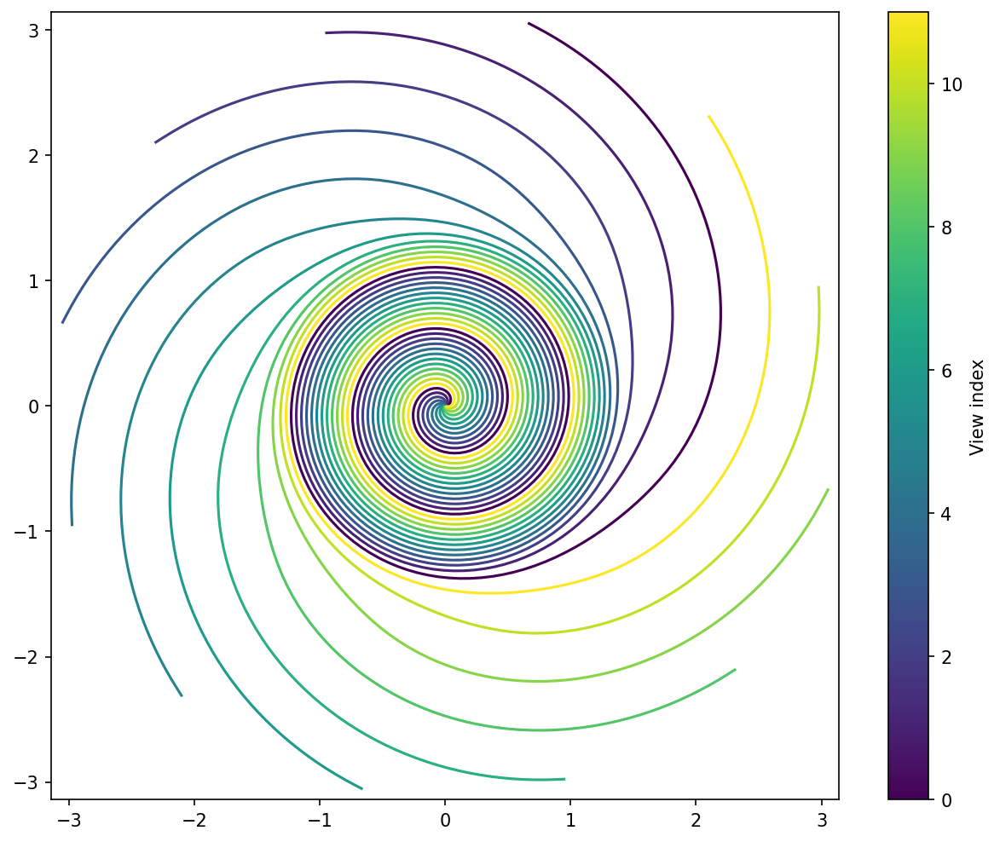

spiral_time_trajectory.shape:  (20, 12, 1950, 2)
spiral_time_trajectory.shape:  (20, 23400, 2)
spiral_time_density.shape:  (20, 23400)
spiral_time_kspace.shape:  (20, 23400)
spiral_time_recon.shape:  (20, 256, 256)


In [33]:
# Now we need to calculate the 2D+time SPIRAL trajectory

fully_sampled_spiral_interleaves = 20
field_of_view = 380.0 #mm
max_grad_ampl = 24.0 #mT/m
min_rise_time = 8.125 #us/(mT/m)
dwell_time = 1.4 #us
collected_spiral_interleaves = 12

vd_inner_cutoff = 0.4
vd_outer_cutoff = 0.6
vd_outer_density = 0.1

#Get trajectory
spiral_time_trajectory=tfmri.spiral_trajectory(
    base_resolution, fully_sampled_spiral_interleaves, field_of_view, 
    max_grad_ampl, min_rise_time, dwell_time,
    views=collected_spiral_interleaves,phases=nFrames, #views=1,phases=1 <- use this to 
    vd_inner_cutoff=vd_inner_cutoff,
    vd_outer_cutoff=vd_outer_cutoff,
    vd_outer_density=vd_outer_density,
    gradient_delay=0.0,vd_type='hanning')
plot_trajectory_2d(spiral_time_trajectory[0,...]) #Plot the trajectory of the first timeframe

print('spiral_time_trajectory.shape: ', spiral_time_trajectory.shape)
# ((20, 5, 1036, 2)

# The trajectory needs converting from [time, spirals, pts per spiral, x/y]
# to [time, spirals*pts per spiral, x/y]
spiral_time_trajectory = tfmri.sampling.flatten_trajectory(spiral_time_trajectory)
print('spiral_time_trajectory.shape: ', spiral_time_trajectory.shape)
# 20, 5180, 2)

# And claculte the density compensation weights for this trajectory 
spiral_time_density = tfmri.sampling.estimate_density(spiral_time_trajectory, image_shape)
print('spiral_time_density.shape: ', spiral_time_density.shape)
# (20, 5180)

# Now do 2D+t NUFFT to create the undersampled spiral kspace fromt he Cartesian images
spiral_time_kspace = tfmri.signal.nufft(time_image, spiral_time_trajectory,
                             transform_type='type_2',
                             fft_direction='forward')
print('spiral_time_kspace.shape: ', spiral_time_kspace.shape)
# (20, 5180)

# Now lets go back into image space
# Apply density compensation.
spiral_time_kspace /= tf.cast(spiral_time_density, tf.complex64)

# and do 2D+t NUFFT to create the image from the undersampled spiral kspace 
spiral_time_recon = tfmri.signal.nufft(spiral_time_kspace, spiral_time_trajectory,
                          grid_shape=image_shape, # Note that this is still [256, 256]
                          transform_type='type_1',
                          fft_direction='backward')
print('spiral_time_recon.shape: ', spiral_time_recon.shape)
#(20, 256, 256)

# And lets visualise
plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['figure.dpi'] = 150  
plt.ioff()
fig, ax = plt.subplots()

cCoil = 0
t= np.linspace(0,nFrames)
def animate(t):
    plt.imshow(np.concatenate(((np.squeeze(tf.math.abs(time_image[t,:,:]))*100000, np.squeeze(tf.math.abs(spiral_time_recon[t,:,:])))), axis=1), cmap = 'gray')
    plt.title('Multicoil, Image In and Image Out (shown for one coil only)')

matplotlib.animation.FuncAnimation(fig, animate, frames=nFrames)